ControlNet Nedir ve Neden İhtiyaç Duyarız?

Stable Diffusion, metin girdilerinden (prompt) gerçekçi ve yaratıcı görseller üretebilen güçlü bir üretken yapay zeka modelidir. Ancak bu güç, beraberinde bir belirsizlik de getirir. Aynı prompt birden fazla kez çalıştırıldığında, model her seferinde farklı kompozisyonlar, pozlar ve yapılar üretebilir. Bu durum yaratıcılık açısından avantajlı olsa da, belirli bir yapıyı veya düzeni korumak istediğimiz senaryolarda bir sınırlama oluşturur.

İşte ControlNet tam olarak bu noktada devreye girer. ControlNet, Stable Diffusion’a ek bir kontrol mekanizması sunarak, modelin üretim sürecini belirli bir görsel yapıya göre yönlendirmeyi amaçlar.

Bu notebook çalışmasının amacı, ControlNet’in ne olduğunu, neden ortaya çıktığını ve pratikte ne işe yaradığını adım adım, görsel karşılaştırmalar üzerinden kavramaktır.
----------------------------------------------------





In [ ]:
import matplotlib.pyplot as plt
from diffusers.utils import load_image
from controlnet_aux import OpenposeDetector





Görseli Yükle

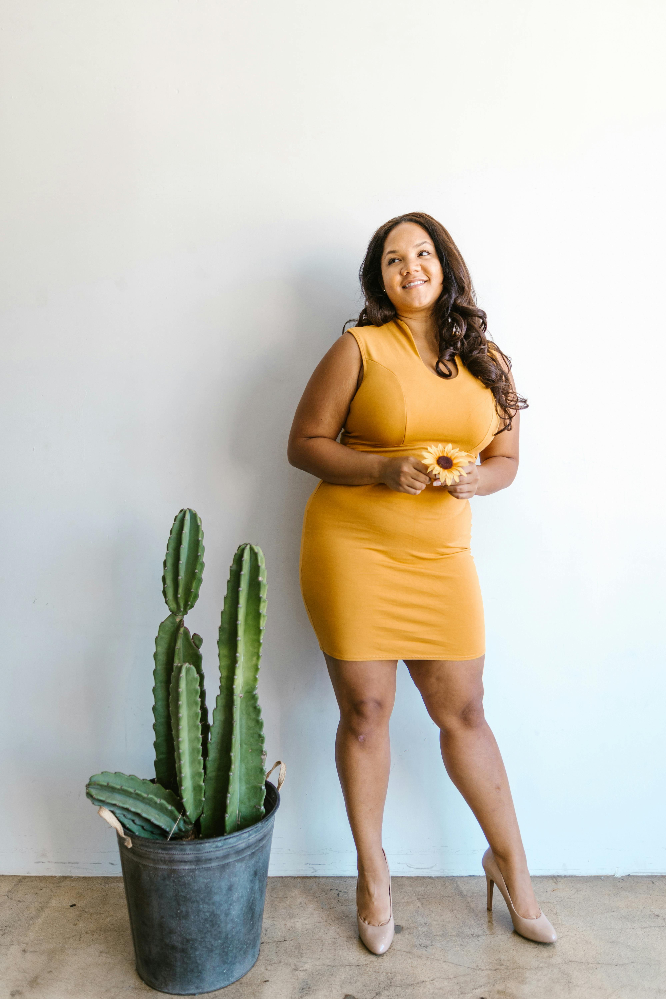

In [2]:
image = load_image("images/input_woman_2.jpg")
image


OpenPose ile Skeleton Çıkar

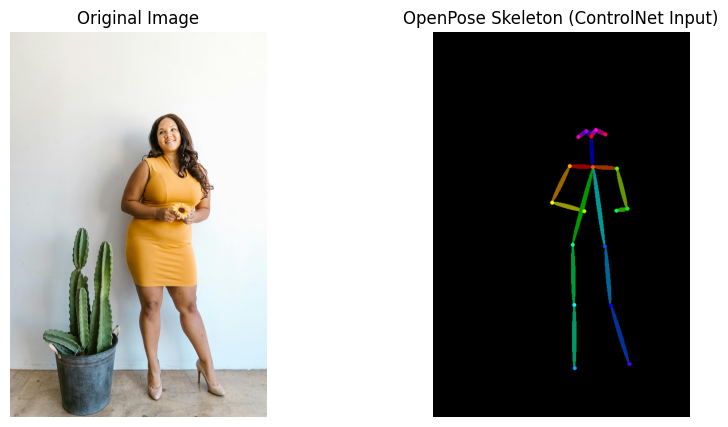

In [3]:
openpose = OpenposeDetector.from_pretrained("lllyasviel/ControlNet")
pose = openpose(image)
pose

fig, ax = plt.subplots(1, 2, figsize=(10, 5))

ax[0].imshow(image)
ax[0].set_title("Original Image")
ax[0].axis("off")

ax[1].imshow(pose)
ax[1].set_title("OpenPose Skeleton (ControlNet Input)")
ax[1].axis("off")

plt.show()


Bu demo, ControlNet’in temel mantığını göstererek bir görüntüden çıkarılan OpenPose iskeletinin, üretim sürecinde yapısal rehber olarak kullanılabileceğini ortaya koymaktadır.

POSE (OpenPose) – “İnsan duruşunu koru”

(-0.5, 511.5, 767.5, -0.5)

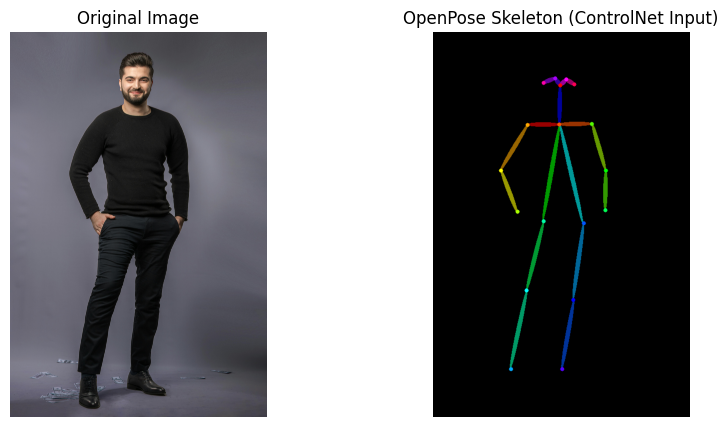

In [5]:
from diffusers.utils import load_image
from controlnet_aux import OpenposeDetector
import matplotlib.pyplot as plt

image = load_image("images/input_man.jpg")

openpose = OpenposeDetector.from_pretrained("lllyasviel/ControlNet")
pose = openpose(image)

fig, ax = plt.subplots(1, 2, figsize=(10, 5))

ax[0].imshow(image)
ax[0].set_title("Original Image")
ax[0].axis("off")

ax[1].imshow(pose)
ax[1].set_title("OpenPose Skeleton (ControlNet Input)")
ax[1].axis("off")


Bu harita, modelin pozdan sapmamasını sağlar.

EDGE MAP (Canny) – “Şekli koru”

(-0.5, 4479.5, 6719.5, -0.5)

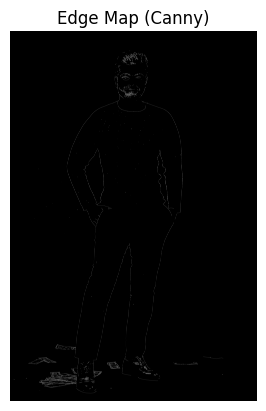

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

gray = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2GRAY)
edges = cv2.Canny(gray, threshold1=100, threshold2=200)

plt.imshow(edges, cmap="gray")
plt.title("Edge Map (Canny)")
plt.axis("off")


Bu harita, modelin şekli ve sınırları korumasını sağlar.

DEPTH MAP – “Yakın–uzak ilişkisini koru"

(-0.5, 4479.5, 6719.5, -0.5)

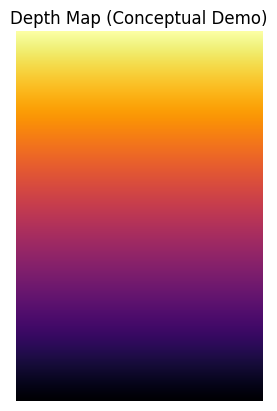

In [7]:
import numpy as np
import matplotlib.pyplot as plt

h, w = image.size[1], image.size[0]
depth_fake = np.tile(np.linspace(1, 0, h), (w, 1)).T

plt.imshow(depth_fake, cmap="inferno")
plt.title("Depth Map (Conceptual Demo)")
plt.axis("off")


“Açık renkler önde, koyu renkler arkada varsayılır.”

Hepsini Yan Yana Görelim:

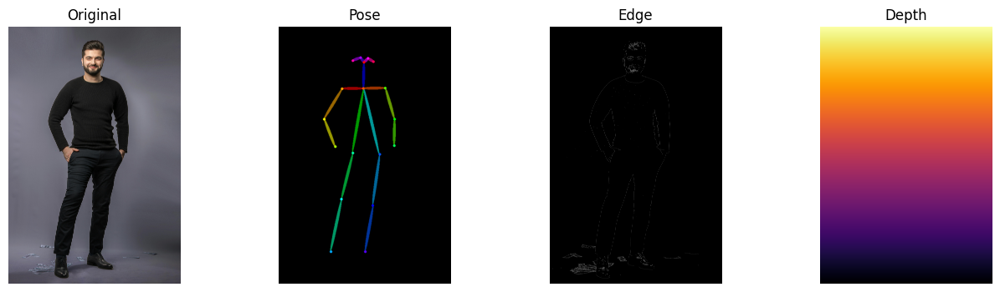

In [8]:
fig, ax = plt.subplots(1, 4, figsize=(16, 4))

ax[0].imshow(image)
ax[0].set_title("Original")
ax[0].axis("off")

ax[1].imshow(pose)
ax[1].set_title("Pose")
ax[1].axis("off")

ax[2].imshow(edges, cmap="gray")
ax[2].set_title("Edge")
ax[2].axis("off")

ax[3].imshow(depth_fake, cmap="inferno")
ax[3].set_title("Depth")
ax[3].axis("off")

plt.show()


Pose, edge ve depth gibi farklı rehber haritalar, üretici modellere yapısal yönlendirme sağlar. 
Pose vücut duruşunu, 
edge nesne sınırlarını, 
depth ise mekânsal derinliği temsil ederek daha kontrollü görsel üretime olanak tanır.